<h1 style='font-size:42px;color:#444;text-align:center'>CBS UYGULAMASI</h1>
<h1 style='font-size:36px;color:#444;text-align:center'>Covid19 Veri Analizi ve Görselleştirme</h1>

<hr></hr>

## Modüllerin Yüklenmesi

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import geopandas as gpd
%matplotlib inline

## Veri Setlerinin Yüklenmesi

In [2]:
# dünya onaylanmış vaka sayıları
confirmed = pd.read_csv('confirmed.csv')
# dünya ölüm sayıları
deaths = pd.read_csv('deaths.csv')
# dünya iyileşen sayıları
recovered = pd.read_csv('recovered.csv')

## Veri Seti Hakkında Bilgi

In [3]:
confirmed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 276 entries, 0 to 275
Columns: 503 entries, Province/State to 6/3/21
dtypes: float64(2), int64(499), object(2)
memory usage: 1.1+ MB


In [4]:
deaths.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 276 entries, 0 to 275
Columns: 503 entries, Province/State to 6/3/21
dtypes: float64(2), int64(499), object(2)
memory usage: 1.1+ MB


In [5]:
recovered.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 261 entries, 0 to 260
Columns: 503 entries, Province/State to 6/3/21
dtypes: float64(2), int64(499), object(2)
memory usage: 1.0+ MB


## İstatistiksel Veriler

In [6]:
confirmed.describe().T

,count,mean,std,min,25%,50%,75%,max
Lat,274.0,20.447559,2.518984e+01,-51.7963,4.933349,21.607878,40.950592,7.170690e+01
Long,274.0,22.328281,7.436910e+01,-178.1165,-22.036550,20.921188,83.380449,1.780650e+02
1/22/20,276.0,2.018116,2.678174e+01,0.0000,0.000000,0.000000,0.000000,4.440000e+02
1/23/20,276.0,2.373188,2.687957e+01,0.0000,0.000000,0.000000,0.000000,4.440000e+02
1/24/20,276.0,3.409420,3.346416e+01,0.0000,0.000000,0.000000,0.000000,5.490000e+02
...,...,...,...,...,...,...,...,...
5/30/21,276.0,617194.481884,2.890908e+06,0.0000,1352.250000,19177.000000,254386.250000,3.326173e+07
5/31/21,276.0,618565.985507,2.896575e+06,0.0000,1352.250000,19097.500000,254530.250000,3.326751e+07
6/1/21,276.0,620244.927536,2.904189e+06,0.0000,1352.250000,19100.000000,254962.750000,3.329045e+07
6/2/21,276.0,622031.927536,2.911920e+06,0.0000,1356.500000,19102.000000,255755.500000,3.330736e+07


In [7]:
deaths.describe().T

,count,mean,std,min,25%,50%,75%,max
Lat,274.0,20.447559,25.189838,-51.7963,4.933349,21.607878,40.950592,71.7069
Long,274.0,22.328281,74.369096,-178.1165,-22.036550,20.921188,83.380449,178.0650
1/22/20,276.0,0.061594,1.023280,0.0000,0.000000,0.000000,0.000000,17.0000
1/23/20,276.0,0.065217,1.024830,0.0000,0.000000,0.000000,0.000000,17.0000
1/24/20,276.0,0.094203,1.446690,0.0000,0.000000,0.000000,0.000000,24.0000
...,...,...,...,...,...,...,...,...
5/30/21,276.0,12830.931159,54032.103939,0.0000,8.750000,268.000000,3528.250000,594443.0000
5/31/21,276.0,12862.380435,54137.898125,0.0000,8.750000,270.000000,3529.750000,594585.0000
6/1/21,276.0,12917.083333,54378.469075,0.0000,8.750000,275.000000,3535.750000,595223.0000
6/2/21,276.0,13375.594203,55428.221463,0.0000,8.750000,276.000000,3539.500000,595833.0000


In [8]:
recovered.describe().T

,count,mean,std,min,25%,50%,75%,max
Lat,260.0,19.016304,2.463273e+01,-51.7963,4.562000,19.584785,38.991325,7.170690e+01
Long,260.0,27.737245,7.184781e+01,-178.1165,-9.496274,24.242250,90.375625,1.780650e+02
1/22/20,261.0,0.114943,1.737097e+00,0.0000,0.000000,0.000000,0.000000,2.800000e+01
1/23/20,261.0,0.122605,1.740995e+00,0.0000,0.000000,0.000000,0.000000,2.800000e+01
1/24/20,261.0,0.149425,1.932687e+00,0.0000,0.000000,0.000000,0.000000,3.100000e+01
...,...,...,...,...,...,...,...,...
5/30/21,261.0,412377.770115,1.932424e+06,0.0000,1039.000000,13248.000000,191475.000000,2.569234e+07
5/31/21,261.0,414405.237548,1.947267e+06,0.0000,1039.000000,13255.000000,192112.000000,2.594763e+07
6/1/21,261.0,416642.337165,1.962782e+06,0.0000,1039.000000,13256.000000,192823.000000,2.617908e+07
6/2/21,261.0,418666.233716,1.976202e+06,0.0000,1040.000000,13256.000000,193491.000000,2.639058e+07


## Veri Seti

In [9]:
confirmed

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21,5/30/21,5/31/21,6/1/21,6/2/21,6/3/21
0,NaN,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,...,66903,67743,68366,69130,70111,70761,71838,72977,74026,75119
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,132229,132244,132264,132285,132297,132309,132315,132337,132351,132360
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,127361,127646,127926,128198,128456,128725,128913,129218,129640,129976
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,13664,13671,13682,13693,13693,13693,13727,13729,13744,13752
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,32933,33338,33607,33944,34180,34366,34551,34752,34960,35140
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,NaN,Vietnam,14.058324,108.277199,0,2,2,2,2,2,...,5931,6086,6356,6396,6908,7107,7432,7625,7870,8063
272,NaN,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,...,306334,306795,306795,307569,307838,308048,308350,308732,309036,309333
273,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,6670,6688,6696,6723,6731,6737,6742,6751,6759,6767
274,NaN,Zambia,-13.133897,27.849332,0,0,0,0,0,0,...,93428,93627,93947,94430,94751,95050,95263,95821,96563,97388


In [10]:
deaths

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21,5/30/21,5/31/21,6/1/21,6/2/21,6/3/21
0,NaN,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,...,2836,2855,2869,2881,2899,2919,2944,2973,3007,3034
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,2447,2447,2447,2448,2449,2450,2451,2451,2451,2451
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,3433,3440,3448,3455,3460,3465,3472,3480,3490,3497
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,127,127,127,127,127,127,127,127,127,127
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,735,742,745,749,757,764,766,772,780,784
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,NaN,Vietnam,14.058324,108.277199,0,0,0,0,0,0,...,44,45,46,47,47,47,47,48,49,49
272,NaN,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,...,3480,3483,3483,3489,3492,3495,3497,3503,3507,3509
273,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,1311,1313,1315,1316,1319,1320,1321,1322,1323,1325
274,NaN,Zambia,-13.133897,27.849332,0,0,0,0,0,0,...,1271,1273,1275,1275,1276,1278,1281,1282,1284,1288


In [11]:
recovered

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21,5/30/21,5/31/21,6/1/21,6/2/21,6/3/21
0,NaN,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,...,56518,56711,56962,57119,57281,57450,57629,57741,57963,58070
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,128907,128978,129042,129097,129215,129308,129431,129473,129521,129566
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,88672,88861,89040,89232,89419,89625,89839,90057,90281,90517
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,13263,13381,13405,13416,13416,13416,13458,13479,13507,13527
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,27204,27467,27529,27577,27646,27766,28079,28190,28264,28646
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
256,NaN,Vietnam,14.058324,108.277199,0,0,0,0,0,0,...,2794,2853,2853,2896,2896,2950,3029,3043,3085,3085
257,NaN,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,...,299024,299559,299559,300125,300524,300661,300776,300919,301213,301443
258,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,3273,3306,3339,3375,3399,3427,3445,3472,3472,3484
259,NaN,Zambia,-13.133897,27.849332,0,0,0,0,0,0,...,91221,91239,91321,91443,91594,91752,91956,92039,92108,92320


## Gereksiz Sütunların Silinmesi

In [12]:
confirmed = confirmed.drop(columns=["Province/State","Lat","Long"])
deaths = deaths.drop(columns=["Province/State","Lat","Long"])
recovered = recovered.drop(columns=["Province/State","Lat","Long"])

In [13]:
confirmed

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21,5/30/21,5/31/21,6/1/21,6/2/21,6/3/21
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,66903,67743,68366,69130,70111,70761,71838,72977,74026,75119
1,Albania,0,0,0,0,0,0,0,0,0,...,132229,132244,132264,132285,132297,132309,132315,132337,132351,132360
2,Algeria,0,0,0,0,0,0,0,0,0,...,127361,127646,127926,128198,128456,128725,128913,129218,129640,129976
3,Andorra,0,0,0,0,0,0,0,0,0,...,13664,13671,13682,13693,13693,13693,13727,13729,13744,13752
4,Angola,0,0,0,0,0,0,0,0,0,...,32933,33338,33607,33944,34180,34366,34551,34752,34960,35140
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,Vietnam,0,2,2,2,2,2,2,2,2,...,5931,6086,6356,6396,6908,7107,7432,7625,7870,8063
272,West Bank and Gaza,0,0,0,0,0,0,0,0,0,...,306334,306795,306795,307569,307838,308048,308350,308732,309036,309333
273,Yemen,0,0,0,0,0,0,0,0,0,...,6670,6688,6696,6723,6731,6737,6742,6751,6759,6767
274,Zambia,0,0,0,0,0,0,0,0,0,...,93428,93627,93947,94430,94751,95050,95263,95821,96563,97388


## Ülke İsimlerine Göre Gruplama Toplamını ve Transpozunu Alma

In [14]:
confirmed=confirmed.groupby("Country/Region").aggregate(np.sum).T
deaths=deaths.groupby("Country/Region").aggregate(np.sum).T
recovered=recovered.groupby("Country/Region").aggregate(np.sum).T

In [15]:
confirmed

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,4,0,...,0,0,0,0,0,2,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5/30/21,70761,132309,128725,13693,34366,1259,3753609,222636,30105,644586,...,4499937,291488,100124,4,232800,7107,308048,6737,95050,38944
5/31/21,71838,132315,128913,13727,34551,1260,3781784,222670,30118,644815,...,4503231,294503,100335,4,234165,7432,308350,6742,95263,38961
6/1/21,72977,132337,129218,13729,34752,1260,3817139,222778,30124,645152,...,4506333,298006,100495,4,235567,7625,308732,6751,95821,38998
6/2/21,74026,132351,129640,13744,34960,1262,3852156,222870,30137,645552,...,4510597,301524,100726,4,236755,7870,309036,6759,96563,39031


## İndeks İsmini Değiştirme

In [16]:
confirmed.index.name="Date"
deaths.index.name="Date"
recovered.index.name="Date"

In [17]:
confirmed

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,4,0,...,0,0,0,0,0,2,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5/30/21,70761,132309,128725,13693,34366,1259,3753609,222636,30105,644586,...,4499937,291488,100124,4,232800,7107,308048,6737,95050,38944
5/31/21,71838,132315,128913,13727,34551,1260,3781784,222670,30118,644815,...,4503231,294503,100335,4,234165,7432,308350,6742,95263,38961
6/1/21,72977,132337,129218,13729,34752,1260,3817139,222778,30124,645152,...,4506333,298006,100495,4,235567,7625,308732,6751,95821,38998


## İndeks Resetleme

In [18]:
confirmed=confirmed.reset_index()
deaths=deaths.reset_index()
recovered=recovered.reset_index()

In [19]:
confirmed

Country/Region,Date,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
0,1/22/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1/23/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
2,1/24/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
3,1/25/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,0,0,0,0
4,1/26/20,0,0,0,0,0,0,0,0,4,...,0,0,0,0,0,2,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494,5/30/21,70761,132309,128725,13693,34366,1259,3753609,222636,30105,...,4499937,291488,100124,4,232800,7107,308048,6737,95050,38944
495,5/31/21,71838,132315,128913,13727,34551,1260,3781784,222670,30118,...,4503231,294503,100335,4,234165,7432,308350,6742,95263,38961
496,6/1/21,72977,132337,129218,13729,34752,1260,3817139,222778,30124,...,4506333,298006,100495,4,235567,7625,308732,6751,95821,38998
497,6/2/21,74026,132351,129640,13744,34960,1262,3852156,222870,30137,...,4510597,301524,100726,4,236755,7870,309036,6759,96563,39031


## Tarihe Göre Verileri Bir Arada Gösterme

In [20]:
confirmed=confirmed.melt(id_vars=["Date"],var_name="Country",value_name="Confirmed")
deaths=deaths.melt(id_vars=["Date"],var_name="Country",value_name="Deaths")
recovered=recovered.melt(id_vars=["Date"],var_name="Country",value_name="Recovered")

In [21]:
confirmed

,Date,Country,Confirmed
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
96302,5/30/21,Zimbabwe,38944
96303,5/31/21,Zimbabwe,38961
96304,6/1/21,Zimbabwe,38998
96305,6/2/21,Zimbabwe,39031


In [22]:
deaths

,Date,Country,Deaths
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
96302,5/30/21,Zimbabwe,1594
96303,5/31/21,Zimbabwe,1594
96304,6/1/21,Zimbabwe,1599
96305,6/2/21,Zimbabwe,1599


In [23]:
recovered

,Date,Country,Recovered
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
96302,5/30/21,Zimbabwe,36591
96303,5/31/21,Zimbabwe,36594
96304,6/1/21,Zimbabwe,36624
96305,6/2/21,Zimbabwe,36661


## Date İndeksini Tarih Formatına Çevirme

#### <span style="color:#555;"><b>pd.to_datetime</b> fonksiyonu ile dönüştürme işlemi </span>

In [24]:
confirmed["Date"]=pd.to_datetime(confirmed["Date"])
deaths["Date"]=pd.to_datetime(deaths["Date"])
recovered["Date"]=pd.to_datetime(recovered["Date"])

#### <span style="color:#555;">Tarih Formatı </span>

In [25]:
confirmed["Date"]=confirmed["Date"].dt.strftime("%Y/%m/%d")
deaths["Date"]=deaths["Date"].dt.strftime("%Y/%m/%d")
recovered["Date"]=recovered["Date"].dt.strftime("%Y/%m/%d")

In [26]:
confirmed

,Date,Country,Confirmed
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
96302,2021/05/30,Zimbabwe,38944
96303,2021/05/31,Zimbabwe,38961
96304,2021/06/01,Zimbabwe,38998
96305,2021/06/02,Zimbabwe,39031


In [27]:
deaths

,Date,Country,Deaths
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
96302,2021/05/30,Zimbabwe,1594
96303,2021/05/31,Zimbabwe,1594
96304,2021/06/01,Zimbabwe,1599
96305,2021/06/02,Zimbabwe,1599


In [28]:
recovered

,Date,Country,Recovered
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
96302,2021/05/30,Zimbabwe,36591
96303,2021/05/31,Zimbabwe,36594
96304,2021/06/01,Zimbabwe,36624
96305,2021/06/02,Zimbabwe,36661


In [29]:
max_date=confirmed["Date"].max()
print(type(max_date))
max_date

<class 'str'>


'2021/06/03'

In [30]:
max_confirmed=confirmed[confirmed["Date"]==max_date]
max_deaths=deaths[deaths["Date"]==max_date]
max_recovered=recovered[recovered["Date"]==max_date]
max_confirmed

,Date,Country,Confirmed
498,2021/06/03,Afghanistan,75119
997,2021/06/03,Albania,132360
1496,2021/06/03,Algeria,129976
1995,2021/06/03,Andorra,13752
2494,2021/06/03,Angola,35140
...,...,...,...
94310,2021/06/03,Vietnam,8063
94809,2021/06/03,West Bank and Gaza,309333
95308,2021/06/03,Yemen,6767
95807,2021/06/03,Zambia,97388


## Toplam Vaka Sayısı

In [31]:
total_confirmed=max_confirmed["Confirmed"].sum()
total_confirmed

172169929

## Toplam Ölüm Sayısı

In [32]:
total_deaths=deaths["Deaths"].sum()
total_deaths

642156210

## Toplam İyileşen Sayısı

In [33]:
total_recovered=recovered["Recovered"].sum()
total_recovered

15989001302

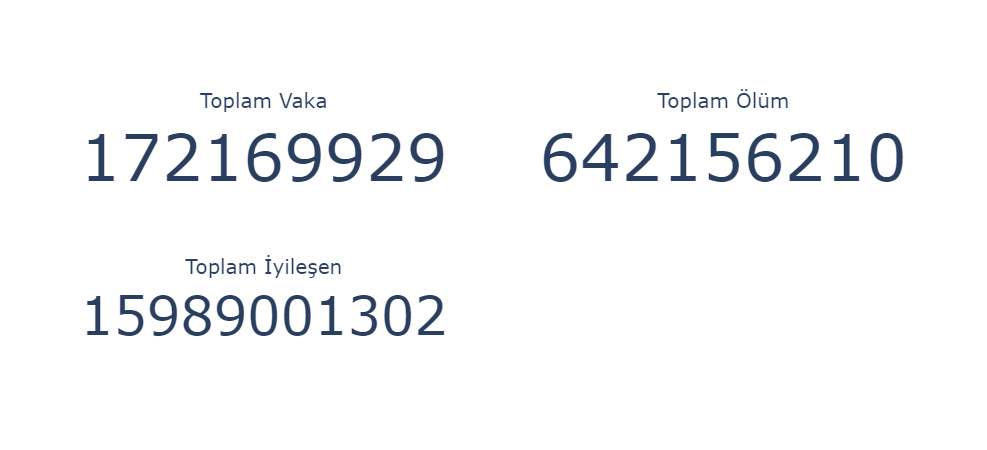

In [34]:
fig=go.Figure()

fig.add_trace(go.Indicator(mode="number",value=int(total_confirmed),number={"valueformat":"0.f"},
             title={"text":"Toplam Vaka"},domain={"row":0,"column":0}))

fig.add_trace(go.Indicator(mode="number",value=int(total_deaths),number={"valueformat":"0.f"},
             title={"text":"Toplam Ölüm"},domain={"row":0,"column":1}))


fig.add_trace(go.Indicator(mode="number",value=int(total_recovered),number={"valueformat":"0.f"},
             title={"text":"Toplam İyileşen"},domain={"row":1,"column":0}))


fig.update_layout(grid={"rows":2,"columns":2,"pattern":"independent"})
fig.show()

## Ülkelere Göre Vaka Sayıları

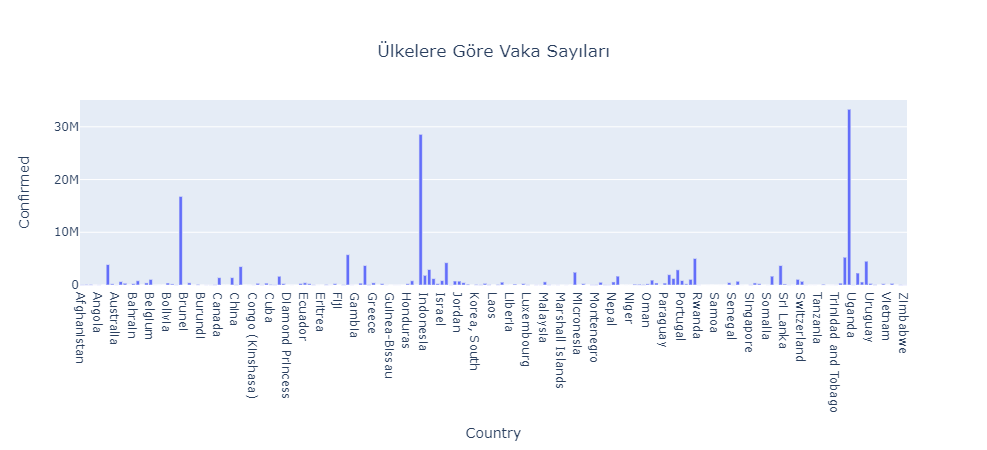

In [35]:
fig=px.bar(max_confirmed,x="Country",y="Confirmed", title="Ülkelere Göre Vaka Sayıları")
fig.update_layout(
    title={
        'text': "Ülkelere Göre Vaka Sayıları",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

## Vaka Sayıları

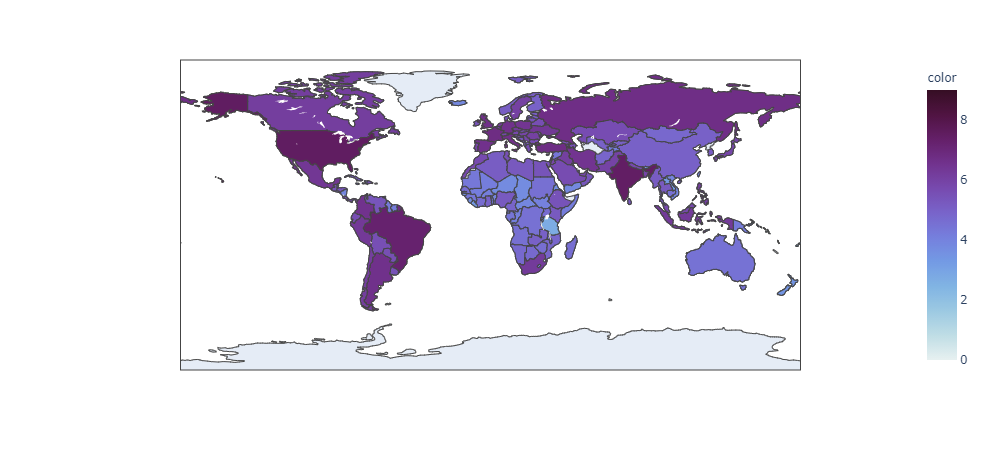

In [36]:
fig=px.choropleth(max_confirmed,locations="Country",locationmode="country names",
                  color_continuous_scale="dense",
                  color=np.log10(max_confirmed["Confirmed"]),range_color=(0,9))
fig.show()

## Vaka Sayıları

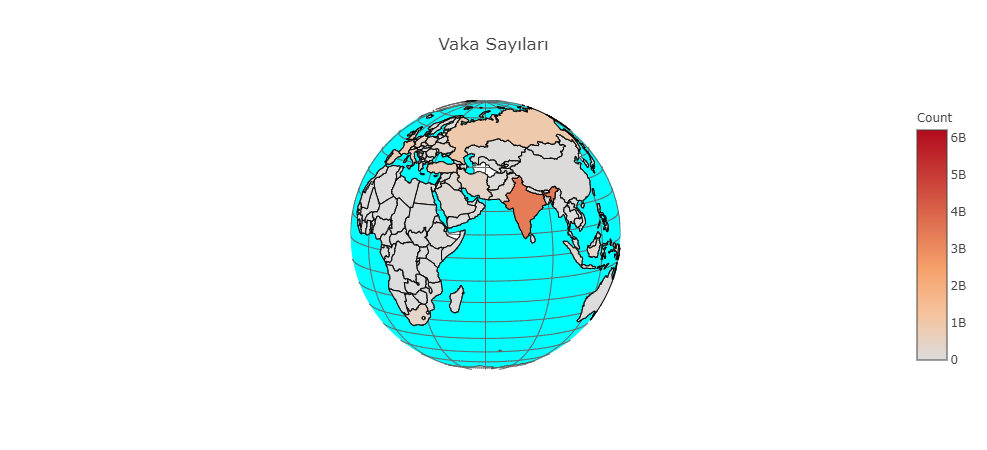

In [37]:
import plotly.offline as py
py.init_notebook_mode(connected=True)

countries = np.unique(confirmed['Country'])
mean_conf = []
for country in countries:
    mean_conf.append(confirmed[confirmed['Country'] == country]['Confirmed'].sum())

    data = [ dict(
        type = 'choropleth',
        locations = countries,
        z = mean_conf,
        locationmode = 'country names',
        text = countries,
        marker = dict(
            line = dict(color = 'rgb(0,0,0)', width = 1)),
            colorbar = dict(autotick = True, tickprefix = '', 
            title = 'Count')
            )
       ]

    layout = dict(
    title = 'Vaka Sayıları',
    geo = dict(
        showframe = False,
        showocean = True,
        oceancolor = 'rgb(0,255,255)',
        projection = dict(
        type = 'orthographic',
            rotation = dict(
                    lon = 60,
                    lat = 10),
        ),
        lonaxis =  dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
            ),
        lataxis = dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
                )
            ),
        )

fig = dict(data=data, layout=layout)
py.iplot(fig, validate=False, filename='worldmap')

## Zamana Göre Vaka Sayıları

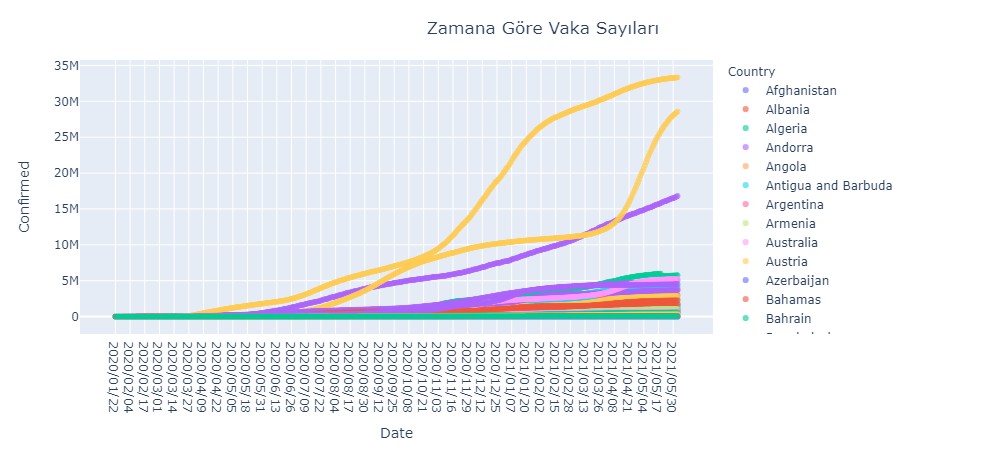

In [38]:
fig=px.scatter(confirmed,x="Date",y="Confirmed",color="Country")
fig.update_traces(opacity=0.6)
fig.update_layout(
    title={
        'text': "Zamana Göre Vaka Sayıları",
        'y':0.95,
        'x':0.55,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

## Vaka Sayısı En Yüksek 10 Ülke

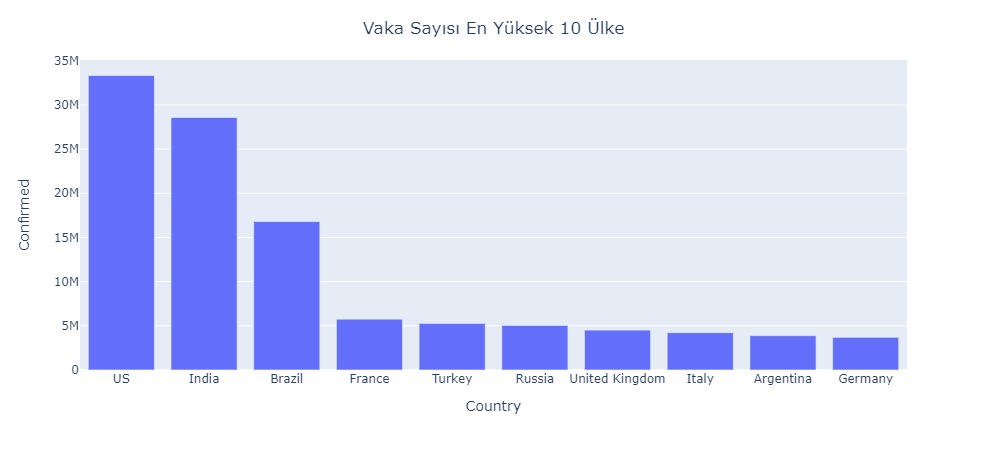

In [39]:
fig=px.bar(max_confirmed.sort_values("Confirmed",ascending=False).head(10),x="Country",y="Confirmed")
fig.update_layout(
    title={
        'text': "Vaka Sayısı En Yüksek 10 Ülke",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

## Ülkelerin Vaka/İyileşen Grafiği

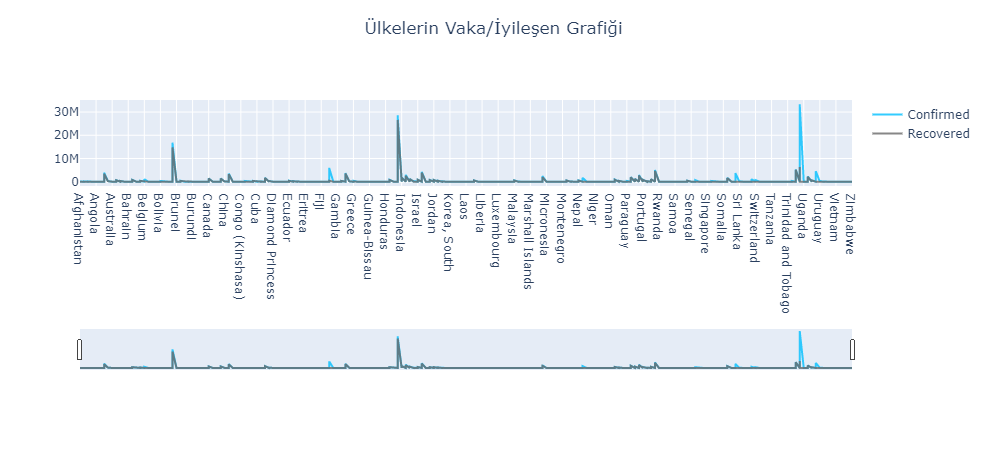

In [40]:
fig = go.Figure()
fig.add_trace(go.Scatter(
                x=confirmed.Country,
                y=confirmed['Confirmed'],
                name="Confirmed",
                line_color='deepskyblue',
                opacity=0.8))

fig.add_trace(go.Scatter(
                x=recovered.Country,
                y=recovered['Recovered'],
                name="Recovered",
                line_color='dimgray',
                opacity=0.8))
fig.update_layout(    title={
        'text': "Ülkelerin Vaka/İyileşen Grafiği",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        xaxis_rangeslider_visible=True)
fig.show()

## Türkiye Zamana Göre Vaka Sayısı Artışı

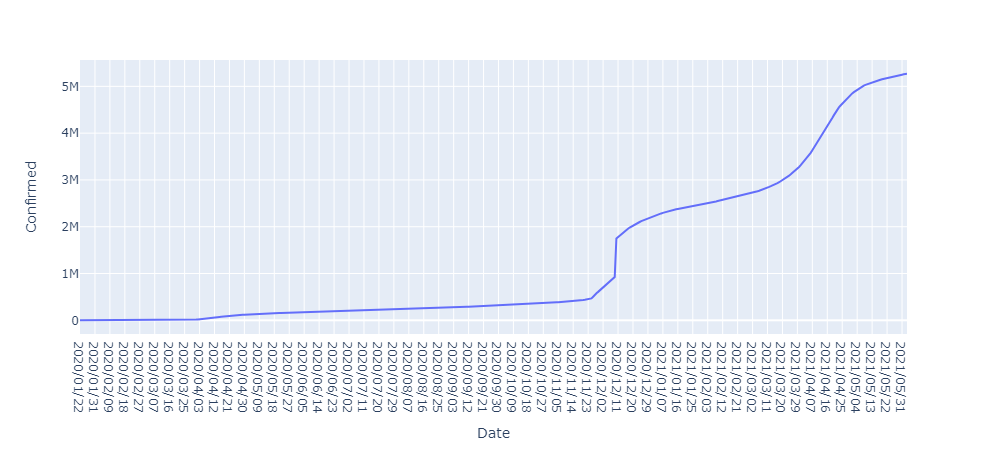

In [41]:
figure=px.line(confirmed[confirmed["Country"]=="Turkey"],x="Date",y="Confirmed")
figure

## Çoklu Grafik

### Çoklu grafik için kolonları diziye çevirme

In [42]:
series_confirmed = pd.Series.to_list(max_confirmed['Confirmed'])
series_deaths = pd.Series.to_list(max_deaths['Deaths'])
series_recovered = pd.Series.to_list(max_recovered['Recovered'])
np_confirmed = np.array(series_confirmed)
np_deaths = np.array(series_deaths)
np_recovered = np.array(series_recovered)